In [67]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
from imblearn import under_sampling, over_sampling
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score, recall_score, precision_score
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.metrics import (classification_report, plot_roc_curve, f1_score, roc_auc_score, balanced_accuracy_score)
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_selection import SelectKBest, SelectFromModel, chi2, mutual_info_classif
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.feature_selection import SelectKBest, mutual_info_classif
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import RobustScaler
from sklearn.pipeline import FeatureUnion
from sklearn.preprocessing import PolynomialFeatures
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.metrics import f1_score
from sklearn.pipeline import Pipeline
from joblib import dump, load
import lightgbm as lgb


pd.set_option("display.max_columns", None)

In [8]:
df=pd.read_csv('../Data/Shanghai AQI and Wheather 2014-2021.csv')

df

,date,maxtempC,mintempC,totalSnow_cm,sunHour,uvIndex,moon_illumination,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph,AQI,AQI_Explained
0,2014-01-01,15.0,5.0,0.0,8.7,4.0,0.0,-1.0,11.0,12.0,11.0,17.0,0.0,43.0,0.0,1021.0,15.0,10.0,242.0,12.0,319.0,Hazardous
1,2014-01-02,14.0,7.0,0.0,8.7,4.0,2.0,4.0,11.0,13.0,11.0,21.0,3.0,60.0,0.0,1019.0,14.0,10.0,141.0,14.0,352.0,Hazardous
2,2014-01-03,16.0,9.0,0.0,8.7,4.0,10.0,3.0,11.0,12.0,11.0,21.0,26.0,55.0,0.0,1017.0,16.0,10.0,295.0,14.0,338.0,Hazardous
3,2014-01-04,10.0,4.0,0.0,5.5,2.0,17.0,3.0,7.0,9.0,7.0,17.0,24.0,68.0,0.1,1022.0,10.0,10.0,169.0,14.0,355.0,Hazardous
4,2014-01-05,10.0,3.0,0.0,8.7,3.0,24.0,3.0,9.0,9.0,9.0,9.0,12.0,66.0,0.0,1024.0,10.0,10.0,117.0,6.0,343.0,Hazardous
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2497,2021-01-26,12.0,10.0,0.0,4.0,3.0,88.0,7.0,10.0,11.0,10.0,12.0,91.0,77.0,1.1,1023.0,12.0,8.0,233.0,9.0,229.0,Very unhealthy
2498,2021-01-27,11.0,7.0,0.0,8.7,2.0,96.0,4.0,7.0,9.0,7.0,13.0,55.0,72.0,0.0,1024.0,11.0,10.0,49.0,11.0,200.0,Unhealthy
2499,2021-01-28,10.0,4.0,0.0,8.7,3.0,100.0,-5.0,5.0,8.0,5.0,24.0,16.0,44.0,0.0,1028.0,10.0,10.0,291.0,19.0,309.0,Hazardous
2500,2021-01-29,9.0,6.0,0.0,8.7,3.0,90.0,-9.0,5.0,7.0,5.0,11.0,0.0,32.0,0.0,1030.0,9.0,10.0,188.0,10.0,320.0,Hazardous


In [9]:
df.describe()

,maxtempC,mintempC,totalSnow_cm,sunHour,uvIndex,moon_illumination,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph,AQI
count,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000,2502.000000
mean,21.445643,15.049161,0.001679,9.620064,4.693845,46.268985,12.917666,19.448441,20.195843,18.068745,17.294964,46.630695,71.049960,1.838849,1016.412070,21.445643,9.539568,153.968425,12.639888,236.598721
std,8.507496,8.045625,0.040454,3.129641,1.739478,31.279000,8.897817,10.480134,9.673024,8.793790,6.671845,30.686734,13.363236,6.081774,8.930989,8.507496,1.296442,75.989626,4.497569,77.295047
min,-3.000000,-6.000000,0.000000,3.800000,1.000000,0.000000,-23.000000,-9.000000,-3.000000,-9.000000,4.000000,0.000000,18.000000,0.000000,986.000000,-3.000000,3.000000,8.000000,3.000000,95.000000
25%,14.000000,8.000000,0.000000,8.000000,3.000000,19.000000,6.000000,11.000000,12.000000,11.000000,13.000000,19.000000,63.000000,0.000000,1009.000000,14.000000,9.000000,99.000000,10.000000,162.000000
50%,23.000000,16.000000,0.000000,9.000000,5.000000,46.000000,13.000000,20.000000,20.000000,20.000000,16.000000,44.000000,73.000000,0.000000,1016.000000,23.000000,10.000000,144.000000,12.000000,237.000000
75%,28.000000,22.000000,0.000000,12.700000,6.000000,73.000000,21.000000,27.000000,27.000000,25.000000,21.000000,73.000000,81.000000,1.100000,1023.750000,28.000000,10.000000,201.000000,15.000000,310.000000
max,40.000000,31.000000,1.700000,14.500000,9.000000,100.000000,28.000000,45.000000,45.000000,36.000000,82.000000,100.000000,97.000000,126.800000,1039.000000,40.000000,20.000000,347.000000,51.000000,522.000000


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2502 entries, 0 to 2501
Data columns (total 22 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   date               2502 non-null   object 
 1   maxtempC           2502 non-null   float64
 2   mintempC           2502 non-null   float64
 3   totalSnow_cm       2502 non-null   float64
 4   sunHour            2502 non-null   float64
 5   uvIndex            2502 non-null   float64
 6   moon_illumination  2502 non-null   float64
 7   DewPointC          2502 non-null   float64
 8   FeelsLikeC         2502 non-null   float64
 9   HeatIndexC         2502 non-null   float64
 10  WindChillC         2502 non-null   float64
 11  WindGustKmph       2502 non-null   float64
 12  cloudcover         2502 non-null   float64
 13  humidity           2502 non-null   float64
 14  precipMM           2502 non-null   float64
 15  pressure           2502 non-null   float64
 16  tempC              2502 

In [11]:
del df['date']

#air quality index >200 means the air is very unhealthy or even hazardous 

df['Safe'] = np.where(df['AQI'] < 200, 1, 0) 

del df['AQI']

df['Safe'].value_counts()

0    1536
1     966
Name: Safe, dtype: int64

In [12]:
ProfileReport(df, title="Pandas Profiling Report")

In [14]:
del df['moon_illumination']
del df['totalSnow_cm']
del df['maxtempC']
del df['mintempC']
del df['uvIndex']
del df['sunHour']
del df['DewPointC']
del df['FeelsLikeC']
del df['HeatIndexC']
del df['WindGustKmph']

In [17]:
del df['AQI_Explained']

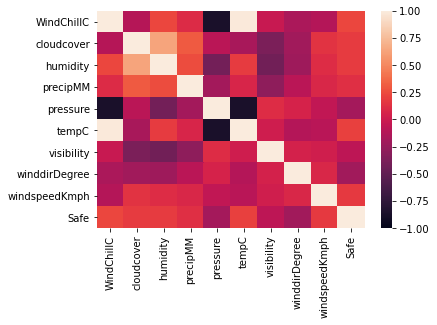

In [20]:
ax = sns. heatmap(df.corr(), vmin=-1)

In [21]:
del df['WindChillC']

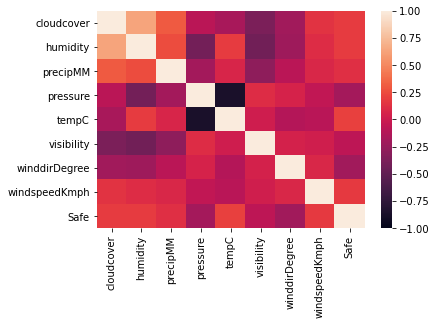

In [22]:
ax = sns. heatmap(df.corr(), vmin=-1)

In [25]:
X = df.loc[:, df.columns != 'Safe']
y = df.loc[:, df.columns == 'Safe']

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.1)

In [31]:
classifiers = [
    LogisticRegression(class_weight='balanced'),
    SVC(class_weight='balanced')
    ]

for classifier in classifiers:
    pipe = Pipeline(steps=[('scaler', StandardScaler()),
                      ('classifier', classifier)])
    pipe.fit(X_train, y_train)
    predictions = pipe.predict(X_test)
    print(str(classifier).split('(')[0], ' - accuracy:', round(pipe.score(X_test, y_test), 2))
    print(str(classifier).split('(')[0], ' - balanced accuracy:', round(balanced_accuracy_score(y_test, predictions),2))
    print(str(classifier).split('(')[0], ' - macro f1:', round(f1_score(y_test, predictions, average='macro'),2))
    print('class ratios: \n', pd.Series(predictions).value_counts()/predictions.shape[0], '\n')

C:\Users\marok\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\marok\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


LogisticRegression  - accuracy: 0.67
LogisticRegression  - balanced accuracy: 0.68
LogisticRegression  - macro f1: 0.66
class ratios: 
 1    0.513944
0    0.486056
dtype: float64 

SVC  - accuracy: 0.72
SVC  - balanced accuracy: 0.72
SVC  - macro f1: 0.71
class ratios: 
 0    0.573705
1    0.426295
dtype: float64 



In [32]:
oversample = SMOTE()
xsmote, ysmote = oversample.fit_resample(X_train, y_train)

clf=SVC(class_weight='balanced')
clf.fit(xsmote, ysmote)
predictions=clf.predict(X_test)
print(classification_report(y_test, predictions))

C:\Users\marok\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


              precision    recall  f1-score   support

           0       0.75      0.54      0.63       160
           1       0.46      0.69      0.55        91

    accuracy                           0.59       251
   macro avg       0.61      0.61      0.59       251
weighted avg       0.65      0.59      0.60       251



In [65]:
clf = RandomForestClassifier(max_depth=10)


clf.fit(X_train, y_train)
predictions = clf.predict(X_test)
print(classification_report(y_test, predictions))

<ipython-input-65-a51bb474b4f1>:4: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(X_train, y_train)


              precision    recall  f1-score   support

           0       0.76      0.88      0.81       160
           1       0.70      0.52      0.59        91

    accuracy                           0.75       251
   macro avg       0.73      0.70      0.70       251
weighted avg       0.74      0.75      0.73       251



In [38]:
clf = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0).fit(xsmote,ysmote)
clf.score(xsmote, ysmote)
predictions=clf.predict(X_test)
print(classification_report(y_test, predictions))

C:\Users\marok\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


              precision    recall  f1-score   support

           0       0.78      0.69      0.74       160
           1       0.55      0.66      0.60        91

    accuracy                           0.68       251
   macro avg       0.67      0.68      0.67       251
weighted avg       0.70      0.68      0.69       251



In [41]:
from sklearn.ensemble import AdaBoostClassifier

clf=AdaBoostClassifier()
clf.fit(xsmote,ysmote)
predictions=clf.predict(X_test)
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

           0       0.79      0.65      0.71       160
           1       0.53      0.70      0.61        91

    accuracy                           0.67       251
   macro avg       0.66      0.68      0.66       251
weighted avg       0.70      0.67      0.68       251



C:\Users\marok\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


In [43]:
from sklearn.ensemble import BaggingClassifier
from sklearn.datasets import make_classification
from sklearn.tree import DecisionTreeClassifier

clf = BaggingClassifier(base_estimator=DecisionTreeClassifier()).fit(xsmote,ysmote)
predictions=clf.predict(X_test)
accuracy_score(y_test, predictions)
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

           0       0.74      0.76      0.75       160
           1       0.56      0.53      0.54        91

    accuracy                           0.68       251
   macro avg       0.65      0.64      0.65       251
weighted avg       0.67      0.68      0.68       251



C:\Users\marok\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


In [103]:
pipe = Pipeline([
    ('impute', KNNImputer()),
    ('scaler', RobustScaler()),
    ('feat_generation', PolynomialFeatures(interaction_only=True, include_bias=False)),
    ('feat_selection', SelectKBest(mutual_info_classif)),
    ('classifier', RandomForestClassifier())
])

parameters = {
    'impute__n_neighbors':[2],
    'classifier__n_estimators':[100],
    'feat_selection__k':[15,30],
    'classifier__class_weight': ['balanced']       
    }

CV = GridSearchCV(pipe, parameters, 
                  scoring='f1_macro', n_jobs=-1, verbose=1, cv=3)
CV.fit(xsmote,ysmote)
pd.DataFrame(CV.cv_results_)

Fitting 3 folds for each of 2 candidates, totalling 6 fits


C:\Users\marok\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\marok\anaconda3\lib\site-packages\sklearn\pipeline.py:346: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__class_weight,param_classifier__n_estimators,param_feat_selection__k,param_impute__n_neighbors,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,1.174457,0.015681,0.038559,0.004620,balanced,100,15,2,"{'classifier__class_weight': 'balanced', 'clas...",0.681099,0.698226,0.799689,0.726338,0.052336,2
1,1.175826,0.148549,0.040236,0.000033,balanced,100,30,2,"{'classifier__class_weight': 'balanced', 'clas...",0.718262,0.713656,0.786373,0.739431,0.033247,1


In [102]:
pipe = Pipeline([
    ('impute', KNNImputer()),
    ('scaler', RobustScaler()),
    ('feat_generation', PolynomialFeatures(interaction_only=True, include_bias=False)),
    ('feat_selection', SelectKBest(mutual_info_classif)),
    ('classifier', RandomForestClassifier())
])

parameters = {
    'impute__n_neighbors':[2,5,10],
    'classifier__n_estimators':[50,100,200],
    'feat_selection__k':[5,10,15,30],
    'classifier__class_weight': ['balanced']       
    }

CV = GridSearchCV(pipe, parameters, 
                  scoring='f1_macro', n_jobs=-1, verbose=1, cv=3)
CV.fit(xsmote, ysmote)
pd.DataFrame(CV.cv_results_)

Fitting 3 folds for each of 36 candidates, totalling 108 fits


C:\Users\marok\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\marok\anaconda3\lib\site-packages\sklearn\pipeline.py:346: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier__class_weight,param_classifier__n_estimators,param_feat_selection__k,param_impute__n_neighbors,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.851452,0.017103,0.025513,0.003778,balanced,50,5,2,"{'classifier__class_weight': 'balanced', 'clas...",0.636175,0.632489,0.735459,0.668041,0.047696,31
1,0.901274,0.038861,0.027322,0.006040,balanced,50,5,5,"{'classifier__class_weight': 'balanced', 'clas...",0.628720,0.641980,0.700940,0.657213,0.031390,36
2,1.007461,0.124537,0.038232,0.014597,balanced,50,5,10,"{'classifier__class_weight': 'balanced', 'clas...",0.630930,0.637375,0.744818,0.671041,0.052235,30
3,1.317195,0.009177,0.050200,0.003849,balanced,50,10,2,"{'classifier__class_weight': 'balanced', 'clas...",0.673843,0.676074,0.775778,0.708565,0.047536,25
4,1.422716,0.029158,0.089098,0.026218,balanced,50,10,5,"{'classifier__class_weight': 'balanced', 'clas...",0.674431,0.669388,0.736685,0.693501,0.030605,27
5,1.299088,0.108326,0.039407,0.013774,balanced,50,10,10,"{'classifier__class_weight': 'balanced', 'clas...",0.676928,0.674411,0.806611,0.719317,0.061735,17
6,1.022768,0.136287,0.020134,0.000035,balanced,50,15,2,"{'classifier__class_weight': 'balanced', 'clas...",0.692994,0.685240,0.787437,0.721891,0.046456,15
7,0.838976,0.012520,0.020136,0.000021,balanced,50,15,5,"{'classifier__class_weight': 'balanced', 'clas...",0.681012,0.681386,0.782288,0.714895,0.047654,22
8,1.716184,0.411543,0.044936,0.031120,balanced,50,15,10,"{'classifier__class_weight': 'balanced', 'clas...",0.683497,0.674171,0.783910,0.713859,0.049679,23
9,2.076538,0.320678,0.029117,0.006908,balanced,50,30,2,"{'classifier__class_weight': 'balanced', 'clas...",0.727475,0.702727,0.796718,0.742306,0.039779,4


In [113]:
pipe = Pipeline([
    ('impute', KNNImputer(n_neighbors=10)),
    ('scaler', RobustScaler()),
    ('feat_generation', PolynomialFeatures(interaction_only=True, include_bias=False)),
    ('feat_selection', SelectKBest(mutual_info_classif, k=30)),
    ('classifier', RandomForestClassifier(n_estimators=100, max_depth=10))
])



pipe.fit(xsmote,ysmote)
p = pipe.predict(X_test)
print(classification_report(y_test, p))

C:\Users\marok\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\marok\anaconda3\lib\site-packages\sklearn\pipeline.py:346: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)


              precision    recall  f1-score   support

           0       0.79      0.79      0.79       160
           1       0.63      0.63      0.63        91

    accuracy                           0.73       251
   macro avg       0.71      0.71      0.71       251
weighted avg       0.73      0.73      0.73       251



In [114]:
from sklearn import metrics

rec=metrics.recall_score(y_test,p)

pre=metrics.precision_score(y_test,p)

F1 = 2 * (pre * rec) / (pre + rec)

fpr, tpr, thresholds= metrics.roc_curve(y_test, p)
auc=metrics.auc(fpr, tpr)

bs= metrics.balanced_accuracy_score(y_test, p)

rec, pre, F1, auc, bs

(0.6263736263736264,
 0.6263736263736264,
 0.6263736263736264,
 0.7069368131868131,
 0.7069368131868132)

In [115]:
from sklearn.metrics import confusion_matrix

C=confusion_matrix(y_test,p)
print(C)

[[126  34]
 [ 34  57]]


In [116]:
pipe = Pipeline([
    ('impute', KNNImputer()),
    ('scaler', RobustScaler()),
    ('feat_generation', PolynomialFeatures(interaction_only=True, include_bias=False)),
    ('feat_selection', SelectKBest(mutual_info_classif)),
    ('classifier', RandomForestClassifier(max_depth=10))
])

parameters = {
    'impute__n_neighbors':[2],
    'classifier__n_estimators':[100],
    'feat_selection__k':[30],
    'classifier__class_weight': ['balanced']
    }

CV = GridSearchCV(pipe, parameters, n_jobs=-1, cv=3)
CV.fit(X, y)

C:\Users\marok\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\marok\anaconda3\lib\site-packages\sklearn\pipeline.py:346: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)


GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('impute', KNNImputer()),
                                       ('scaler', RobustScaler()),
                                       ('feat_generation',
                                        PolynomialFeatures(include_bias=False,
                                                           interaction_only=True)),
                                       ('feat_selection',
                                        SelectKBest(score_func=<function mutual_info_classif at 0x0000019A90228280>)),
                                       ('classifier',
                                        RandomForestClassifier(max_depth=10))]),
             n_jobs=-1,
             param_grid={'classifier__class_weight': ['balanced'],
                         'classifier__n_estimators': [100],
                         'feat_selection__k': [30],
                         'impute__n_neighbors': [2]})

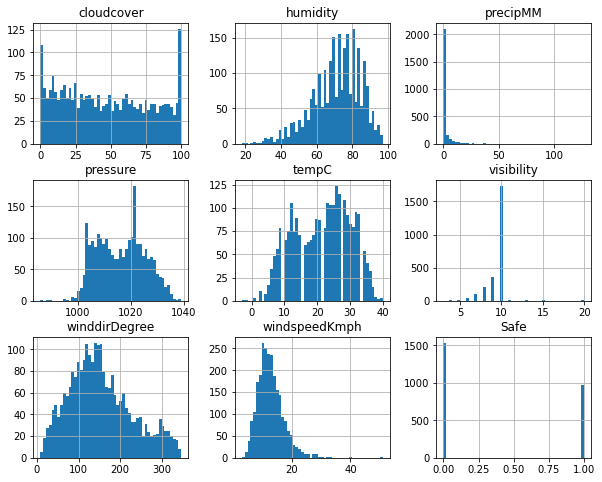

In [119]:
df.hist(bins=50, figsize=(10,8))
plt.show()

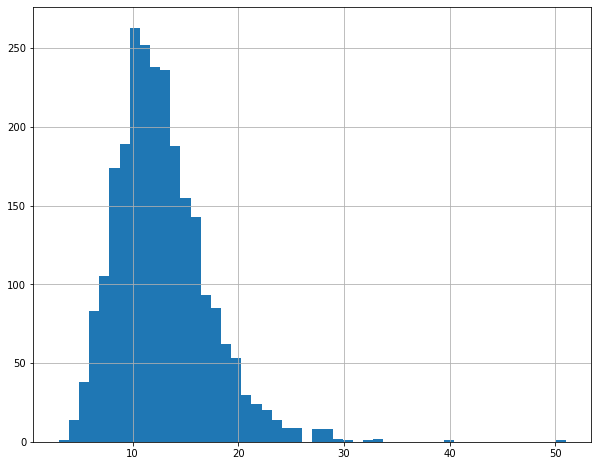

In [131]:
df['windspeedKmph'].hist(bins=50, figsize=(10,8))
plt.show()

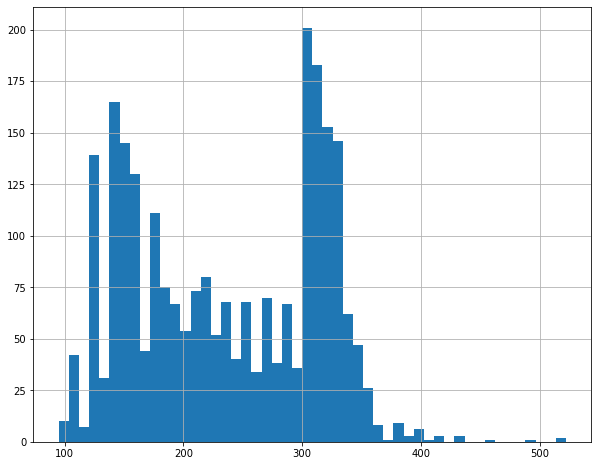

In [132]:
df1=pd.read_csv('../Data/Shanghai AQI and Wheather 2014-2021.csv')


df1['AQI'].hist(bins=50, figsize=(10,8))
plt.show()